**Part1: DATA CLEANING AND PROCESSING**

We will be using a subset of MIT Places dataset of places, landscape and buildings. 


In [ ]:
!wget http://data.csail.mit.edu/places/places205/testSetPlaces205_resize.tar.gz
!tar -xzf testSetPlaces205_resize.tar.gz

--2019-07-23 14:58:55--  http://data.csail.mit.edu/places/places205/testSetPlaces205_resize.tar.gz
Resolving data.csail.mit.edu (data.csail.mit.edu)... 128.52.129.40
Connecting to data.csail.mit.edu (data.csail.mit.edu)|128.52.129.40|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 2341250899 (2.2G) [application/octet-stream]
Saving to: ‘testSetPlaces205_resize.tar.gz’

testSetPlaces205_re 100%[===================>]   2.18G  2.48MB/s    in 15m 56s 

2019-07-23 15:14:51 (2.34 MB/s) - ‘testSetPlaces205_resize.tar.gz’ saved [2341250899/2341250899]



In [ ]:
import os
os.makedirs('images/train/class/', exist_ok=True)
os.makedirs('images/val/class/', exist_ok=True)  
os.makedirs('images/test/class/', exist_ok=True)  

for i, file in enumerate(os.listdir('testSet_resize')):
  if i < 10000:
    os.rename('Set' + file, 'images/val/class/' + file)
  elif i< 40000:
    os.rename('Set' + file, 'images/train/class/' + file)
  else:
    os.rename('Set' + file, 'images/test/class/' + file)

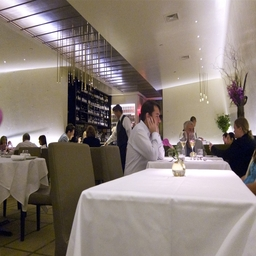

In [ ]:
from IPython.display import Image, display
display(Image(filename='images/val/class/'+str(img_files[400])))

In [ ]:
from skimage import io, color
from skimage.color import rgb2lab, rgb2gray, lab2rgb
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data.sampler import SubsetRandomSampler
import torchvision as tv
import torchvision.transforms as transforms
from torchvision import datasets

import numpy as np
  
import torch.optim as optim
from torch.utils.data.sampler import SubsetRandomSampler
import matplotlib.pyplot as plt
from torch.autograd import Variable
  
 

def get_data_loader(bat_s):
  train_loader = torch.utils.data.DataLoader(train_set, batch_size=bat_s,shuffle=True )
  val_loader = torch.utils.data.DataLoader(val_set, batch_size=bat_s, shuffle=False) 
  return train_loader,val_loader


#def visualize_image(grayscale_input, ab_input=None, show_image=False, save_path=None, save_name=None):


class greyfolder(datasets.ImageFolder):
    def __getitem__(self, index):
        path, target = self.imgs[index]
        img = self.loader(path)
        img_original = self.transform(img)
        img_original = np.asarray(img_original)# numpy


        
        img_lab = rgb2lab(img_original)
            
        img_original = img_lab[:,:,0] # L channel 
        img_original = torch.from_numpy(img_original).unsqueeze(0).float()
            
        img_lab = (img_lab + 128) / 255
        img_ab = img_lab[:, :, 1:3]
        img_ab = torch.from_numpy(img_ab.transpose((2, 0, 1))).float()
            
        return img_original, img_ab
        

In [ ]:
train_transforms = transforms.Compose([
            transforms.RandomSizedCrop(224),
            transforms.RandomHorizontalFlip()
        ])
val_transforms = transforms.Compose([
        transforms.Scale(256),
        transforms.CenterCrop(224)
    ])
train_folder=greyfolder('images/train/',train_transforms)
valid_folder=greyfolder('images/val/',val_transforms)

/usr/local/lib/python3.6/dist-packages/torchvision/transforms/transforms.py:692: UserWarning: The use of the transforms.RandomSizedCrop transform is deprecated, please use transforms.RandomResizedCrop instead.
  "please use transforms.RandomResizedCrop instead.")
/usr/local/lib/python3.6/dist-packages/torchvision/transforms/transforms.py:209: UserWarning: The use of the transforms.Scale transform is deprecated, please use transforms.Resize instead.
  "please use transforms.Resize instead.")


In [ ]:
print("training_set: ",len(train_folder),type(train_folder))
print("validation_set: ",len(valid_folder),type(valid_folder))
print("valid_folder",len(valid_folder[40][1]))

training_set:  40000 <class '__main__.greyfolder'>
validation_set:  1000 <class '__main__.greyfolder'>
valid_folder 2


In [ ]:
print(valid_folder[77][1].shape)#AB colorspace tensor
print(valid_folder[77][0].shape)#L colorspace tensor

torch.Size([2, 224, 224])
torch.Size([1, 224, 224])


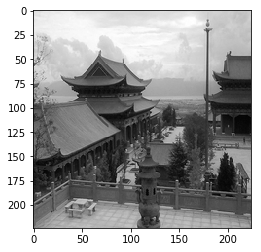

In [ ]:
plt.imshow(valid_folder[77][0][0], cmap="gray")
plt.show()

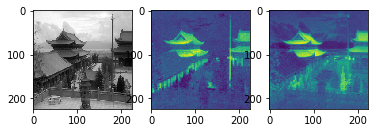

In [ ]:
f, axarr = plt.subplots(1, 3)
axarr[0].imshow(valid_folder[77][0][0], cmap="gray")
axarr[1].imshow(valid_folder[77][1][0])
axarr[2].imshow(valid_folder[77][1][1])

In [ ]:
im_ab = np.zeros((224,224))
im_ab2=im_ab
im_ab=torch.from_numpy(im_ab).float()
im_ab2=torch.from_numpy(im_ab2).float()
#img_ab=torch.cat()
color_image = torch.cat((im_ab, im_ab2), 0).numpy() 
img_l=valid_folder[77][0][0].numpy()

img_l=torch.from_numpy(img_l).float()
color_image=torch.from_numpy(color_image).float()
img_lab=torch.cat((color_image,img_l),0).numpy()

print(len(img_lab))
# img_lab = img_lab.transpose((1, 2, 0))  
# img_lab[:, :, 0:1] = img_lab[:, :, 0:1] * 100
# img_lab[:, :, 1:3] = img_lab[:, :, 1:3] * 255 - 128  

# img_lab = lab2rgb(img_lab.astype(np.float64))
# img_l = img_l.squeeze().numpy()

#  color_image = color_image.transpose((1, 2, 0))  # rescale for matplotlib
#   color_image[:, :, 0:1] = color_image[:, :, 0:1] * 100
#   color_image[:, :, 1:3] = color_image[:, :, 1:3] * 255 - 128   
#   color_image = lab2rgb(color_image.astype(np.float64))
#   grayscale_input = grayscale_input.squeeze().numpy()

672


In [ ]:
img_l=valid_folder[77][0][0].numpy()

img_l=torch.from_numpy(img_l).float()

img_l = img_l.shape

In [ ]:
img_l=valid_folder[77][0]

In [ ]:
img_l=img_l.transpose(0,2)
img_l.shape

torch.Size([224, 224, 1])

In [ ]:
from skimage.color import gray2rgb

In [ ]:
temp=lab2rgb(img_l.numpy())
             

ValueError: ignored

In [ ]:
temp=temp.squeeze(2)
temp.shape

(224, 224, 3)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


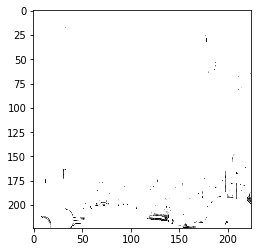

In [ ]:
plt.imshow(temp)
plt.show()

In [ ]:
! ls

images	     sample_data	   testSetPlaces205_resize.tar.gz
imgList.csv  sampleSubmission.csv  testSet_resize
readme.txt   testSampleScript.py   truth_random.csv


In [ ]:
import torch
import torch.nn as nn

class CNN(nn.Module):
    def __init__(self):
        super(CNN, self).__init__()
        self.name = "CNN"
        self.conv1 = nn.Conv2d(1, 1, kernel_size=3, stride=1, padding=1) # Convolutional Layer 1
        self.conv2 = nn.Conv2d(1, 2, kernel_size=3, stride=1, padding=1) # Convolutional Layer 2
        self.conv3 = nn.Conv2d(2, 2, kernel_size=3, stride=1, padding=1) # Convolutional Layer 3

    def forward(self, x):
        x = F.relu(self.conv1(x)) # Activation Function: Relu
        x = F.relu(self.conv2(x)) # Activation Function: Relu
        x = F.relu(self.conv3(x)) # Activation Function: Relu
        return x

In [ ]:
basemodel = CNN().cuda()

In [ ]:
basemodel.train()

CNN(
  (conv1): Conv2d(1, 1, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv2): Conv2d(1, 2, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv3): Conv2d(2, 2, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
)

# Baseline Model

**Base1:**

In [ ]:
import torch
import torch.nn as nn

class CNN(nn.Module):
    def __init__(self):
        super(CNN, self).__init__()
        self.name = "CNN"
        self.conv1 = nn.Conv2d(1, 8, kernel_size=3, stride=2, padding=1) # Convolutional Layer 1
        self.conv2 = nn.Conv2d(8, 2, kernel_size=3, stride=1, padding=1) # Convolutional Layer 2

    def forward(self, x):
        x = F.relu(self.conv1(x)) # Activation Function: Relu
        x = self.conv2(x)
        return x

**Base2**

In [ ]:
import torch as t

class Net(t.nn.Module):
    def __init__(self):
        super(Net,self).__init__()
        self.conv1 = t.nn.Sequential(
            t.nn.Conv2d(1,16,3,stride=2,padding=1),
            t.nn.BatchNorm2d(16),
            t.nn.ReLU(),
            t.nn.Upsample(scale_factor=2)
        )
        self.conv2 = t.nn.Sequential(
            t.nn.Conv2d(16,32,3,2,1),
            t.nn.BatchNorm2d(32),
            t.nn.ReLU(),
            t.nn.Upsample(scale_factor=2)
        )
        self.conv3 = t.nn.Sequential(
            t.nn.Conv2d(32,16,3,2,1),
            t.nn.BatchNorm2d(16),
            t.nn.ReLU(),
            t.nn.Upsample(scale_factor=2)
        )
        self.conv4 = t.nn.Sequential(
            t.nn.Conv2d(16,2,3,2,1),
            t.nn.BatchNorm2d(2),
            t.nn.ReLU(),
            t.nn.Upsample(scale_factor=2)
        )
        
    def forward(self,x):
        x = self.conv1(x)
        x = self.conv2(x)
        x = self.conv3(x)
        x = self.conv4(x)
        return x

# Model Architecture

##**Regression Model**



In [ ]:
!unzip Train.zip
!unzip Validation.zip
!unzip Test.zip

Archive:  Train.zip
   creating: Train/
  inflating: Train/.DS_Store         
   creating: __MACOSX/
   creating: __MACOSX/Train/
  inflating: __MACOSX/Train/._.DS_Store  
   creating: Train/Class/
  inflating: Train/Class/0c58e41fd629a7f76a81dbed4e882a54.jpg  
   creating: __MACOSX/Train/Class/
  inflating: __MACOSX/Train/Class/._0c58e41fd629a7f76a81dbed4e882a54.jpg  
  inflating: Train/Class/0cd0332ab74ca72a1c0700f790fd5af1.jpg  
  inflating: __MACOSX/Train/Class/._0cd0332ab74ca72a1c0700f790fd5af1.jpg  
  inflating: Train/Class/0d300d937a75ddff710a351fb7a5cac9.jpg  
  inflating: __MACOSX/Train/Class/._0d300d937a75ddff710a351fb7a5cac9.jpg  
  inflating: Train/Class/0ad213f5f8c17292402bc972821ae608.jpg  
  inflating: __MACOSX/Train/Class/._0ad213f5f8c17292402bc972821ae608.jpg  
  inflating: Train/Class/0b6e5121263c2b808ae934955b23267f.jpg  
  inflating: __MACOSX/Train/Class/._0b6e5121263c2b808ae934955b23267f.jpg  
  inflating: Train/Class/0dc878753235f7ee0770baff92451b19.jpg  
  inflat

In [ ]:
import torchvision.models as models

class REG(nn.Module):
  def __init__(self, input_size=128):
    super(REG, self).__init__()
    mid = 256
    resnet = models.resnet18(num_classes=365) 
    resnet.conv1.weight = nn.Parameter(resnet.conv1.weight.sum(dim=1).unsqueeze(1)) 
    self.midlevel_resnet = nn.Sequential(*list(resnet.children())[0:7])

    self.upsample = nn.Sequential(     
      nn.Conv2d(mid, 128, kernel_size=3, padding=1),
      nn.BatchNorm2d(128),
      nn.ReLU(),
      nn.Upsample(scale_factor=2),
      nn.Conv2d(128, 64, kernel_size=3, padding=1),
      nn.BatchNorm2d(64),
      nn.ReLU(),
      nn.Upsample(scale_factor=2),
      nn.Conv2d(64, 32, kernel_size=3, padding=1),
      nn.BatchNorm2d(32),
      nn.ReLU(),
      nn.Upsample(scale_factor=2),
      nn.ReLU(),
      nn.Conv2d(32, 2, kernel_size=3, padding=1),
      nn.Upsample(scale_factor=2)
    )

  def forward(self, input):
    mid_feature = self.midlevel_resnet(input)
    output = self.upsample(mid_feature)
    return output

In [ ]:
model = REG().cuda()
model.eval()

In [ ]:
model(temp)

the dimention is torch.Size([1, 128, 28, 28])


tensor([[[[-0.0521, -0.0521,  0.1527,  ...,  0.1463,  0.0525,  0.0525],
          [-0.0521, -0.0521,  0.1527,  ...,  0.1463,  0.0525,  0.0525],
          [ 0.0653,  0.0653,  0.1627,  ...,  0.1599,  0.1055,  0.1055],
          ...,
          [-0.0762, -0.0762, -0.0671,  ...,  0.1102,  0.0973,  0.0973],
          [ 0.0285,  0.0285,  0.2089,  ...,  0.2080,  0.0587,  0.0587],
          [ 0.0285,  0.0285,  0.2089,  ...,  0.2080,  0.0587,  0.0587]],

         [[ 0.0643,  0.0643, -0.1636,  ..., -0.1079,  0.0217,  0.0217],
          [ 0.0643,  0.0643, -0.1636,  ..., -0.1079,  0.0217,  0.0217],
          [ 0.0158,  0.0158, -0.0207,  ..., -0.1593, -0.0734, -0.0734],
          ...,
          [ 0.0303,  0.0303, -0.1976,  ..., -0.2087, -0.1302, -0.1302],
          [ 0.0422,  0.0422,  0.0124,  ..., -0.2191, -0.1285, -0.1285],
          [ 0.0422,  0.0422,  0.0124,  ..., -0.2191, -0.1285, -0.1285]]]],
       grad_fn=<UpsampleNearest2DBackward>)

In [ ]:
def train(train_loader, model, criterion, optimizer, epoch):
  print('Starting training epoch {}'.format(epoch))
  model.train()
  batch_time, data_time, losses = 0, 0, 0
  end = time.time()
  for i, (input_L, input_ab, obj) in enumerate(train_loader):
    if use_gpu: input_L, input_ab, obj = input_L.cuda(), input_ab.cuda(), obj.cuda()
    data_time.update(time.time() - end)
    output_ab = model(input_L) 
    loss = criterion(output_ab, input_ab) 
    losses.update(loss.item(), input_L.size(0))
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()
    batch_time.update(time.time() - end)
    end = time.time()
    if i % 25 == 0:
      print('Epoch: [{0}][{1}/{2}]\t'
            'Time {batch_time.val:.3f} ({batch_time.avg:.3f})\t'
            'Data {data_time.val:.3f} ({data_time.avg:.3f})\t'
            'Loss {loss.val:.4f} ({loss.avg:.4f})\t'.format(
              epoch, i, len(train_loader), batch_time=batch_time,
             data_time=data_time, loss=losses)) 
  print('Finished training epoch {}'.format(epoch))

In [ ]:
def validate(val_loader, model, criterion, save_images, epoch):
  model.eval()
  batch_time, data_time, losses = 0, 0, 0
  end = time.time()
  already_saved_images = False
  for i, (input_gray, input_ab, obj) in enumerate(val_loader):
    data_time.update(time.time() - end)
    if use_gpu: input_gray, input_ab, obj = input_gray.cuda(), input_ab.cuda(), obj.cuda()
    output_ab = model(input_gray)
    loss = criterion(output_ab, input_ab)
    losses.update(loss.item(), input_gray.size(0))
    if save_images and not already_saved_images:
      already_saved_images = True
      for j in range(min(len(output_ab), 10)):
        save_path = {'grayscale': 'outputs/gray/', 'colorized': 'outputs/color/'}
        save_name = 'img-{}-epoch-{}.jpg'.format(i * val_loader.batch_size + j, epoch)
        to_rgb(input_gray[j].cpu(), ab_input=output_ab[j].detach().cpu(), save_path=save_path, save_name=save_name)
    batch_time.update(time.time() - end)
    end = time.time()
    if i % 25 == 0:
      print('Validate: [{0}/{1}]\t'
            'Time {batch_time.val:.3f} ({batch_time.avg:.3f})\t'
            'Loss {loss.val:.4f} ({loss.avg:.4f})\t'.format(
             i, len(val_loader), batch_time=batch_time, loss=losses))
  print('Finished validation.')
  return losses.avg

In [ ]:
def trainModel (model, batch_size, learning_rate, epochs, criterion):
  if use_gpu:# check GPU, if GPU is avaliable, move model and criterion to GPU 
    model=model.cuda()
    criterion=criterion.cuda()
  train_loader=torch.utils.data.DataLoader(train_folder, batch_size=batch_size, shuffle=True)
  val_loader=torch.utils.data.DataLoader(valid_folder, batch_size=batch_size, shuffle=True)
  optimizer=torch.optim.Adam(model.parameters(),lr=learning_rate)
  train_loss = []
  val_loss = []
  
  for j in range (epochs): # iterate through all epochs 
    total_train=0.0
    total_val=0.0
    print("Epoch {}".format(j))
    for i, (input_gray, input_ab) in enumerate (train_loader):# iterate through mini-batches 
      if i%10==0:
        print("Training iteration {}".format(i))
      if use_gpu:
        input_gray, input_ab= input_gray.cuda(), input_ab.cuda()
      output_ab=model(input_gray)
      loss=criterion(output_ab, input_ab)
      loss.backward()
      optimizer.step()
      optimizer.zero_grad()
      total_train+=loss.item()
    train_loss.append(float(total_train/(i+1)))
    print("Valdation")
    for k, (input_gray, input_ab) in enumerate (val_loader):
      if k%100==0:
        print("Validation iteration {}".format(k))
      
      if use_gpu:
        input_gray, input_ab= input_gray.cuda(), input_ab.cuda()
      
      # forward pass 
      output_ab=model(input_gray)
      loss=criterion(output_ab, input_ab)
      total_val+=loss.item()
    
   # record the validation loss 
    val_loss.append(float(total_val/(k+1)))
   # print the training result 
    print("Epoch {}: Train Loss{:.4f}, Val Loss{:.4f}".format(j+1,train_loss[j],val_loss[j]))
    
    
  print("Finish training.")
  plt.title("Training Curve")
  plt.plot(range(1,epochs+1),train_loss, label="Train")
  plt.plot(range(1,epochs+1),val_loss, label="Validation")
  plt.xlabel("Epoch")
  plt.ylabel("Loss")
  plt.legend(loc="best")
  plt.show()

  plt.title("Training Accuracy")
  plt.plot(range(1,epochs+1),train_acc, label="Train")
  plt.plot(range(1,epochs+1),val_acc, label="Validation")
  plt.xlabel("Epoch")
  plt.ylabel("Accuracy")
  plt.legend(loc="best")
  plt.show()

In [ ]:
criterion = nn.MSELoss()

In [ ]:
criterion = nn.SmoothL1Loss()

In [ ]:
criterion = nn.KLDivLoss(size_average=True)

In [ ]:
optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)

In [ ]:
use_gpu = True

In [ ]:
if use_gpu: 
  criterion = criterion.cuda()
  model = model.cuda()

In [ ]:
import os
os.makedirs('outputs/color', exist_ok=True)
os.makedirs('outputs/gray', exist_ok=True)
save_images = True
best_losses = 100
epochs = 100

In [ ]:
import time
for epoch in range(epochs):
  train(train_loader, model, criterion, optimizer, epoch)
  with torch.no_grad():
    losses = validate(val_loader, model, criterion, save_images, epoch)

Starting training epoch 0
Epoch: [0][0/7]	Time 2.283 (2.283)	Data 2.223 (2.223)	Loss 0.5166 (0.5166)	
Finished training epoch 0
Validate: [0/2]	Time 2.522 (2.522)	Loss 0.4694 (0.4694)	
Finished validation.
Starting training epoch 1
Epoch: [1][0/7]	Time 2.196 (2.196)	Data 2.184 (2.184)	Loss 0.4741 (0.4741)	
Finished training epoch 1
Validate: [0/2]	Time 2.569 (2.569)	Loss 0.4262 (0.4262)	
Finished validation.
Starting training epoch 2
Epoch: [2][0/7]	Time 2.215 (2.215)	Data 2.203 (2.203)	Loss 0.4283 (0.4283)	
Finished training epoch 2
Validate: [0/2]	Time 2.449 (2.449)	Loss 0.3865 (0.3865)	
Finished validation.
Starting training epoch 3
Epoch: [3][0/7]	Time 2.130 (2.130)	Data 2.118 (2.118)	Loss 0.3863 (0.3863)	
Finished training epoch 3
Validate: [0/2]	Time 2.455 (2.455)	Loss 0.3502 (0.3502)	
Finished validation.
Starting training epoch 4
Epoch: [4][0/7]	Time 2.121 (2.121)	Data 2.110 (2.110)	Loss 0.3526 (0.3526)	
Finished training epoch 4
Validate: [0/2]	Time 2.479 (2.479)	Loss 0.3172 (

<Figure size 432x288 with 0 Axes>

In [ ]:
trainModel(model=model, batch_size=batch_size, learning_rate=learning_rate, epochs=10, criterion=criterion)

Epoch 0
Training iteration 0
Training iteration 10
Training iteration 20
Training iteration 30
Training iteration 40
Training iteration 50
Training iteration 60
Training iteration 70
Training iteration 80
Training iteration 90
Training iteration 100
Training iteration 110
Training iteration 120
Training iteration 130
Training iteration 140
Training iteration 150
Training iteration 160
Training iteration 170
Training iteration 180
Training iteration 190
Training iteration 200
Training iteration 210
Training iteration 220
Training iteration 230
Training iteration 240
Training iteration 250
Training iteration 260
Training iteration 270
Training iteration 280
Training iteration 290
Training iteration 300
Training iteration 310
Training iteration 320
Training iteration 330
Training iteration 340
Training iteration 350
Training iteration 360
Training iteration 370
Training iteration 380
Training iteration 390
Training iteration 400
Training iteration 410
Training iteration 420
Training itera

KeyboardInterrupt: ignored

torch.Size([1, 1, 224, 224])


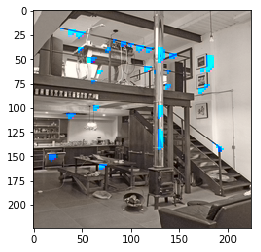

torch.Size([1, 1, 224, 224])


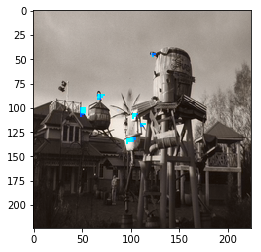

torch.Size([1, 1, 224, 224])


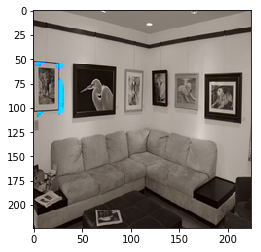

torch.Size([1, 1, 224, 224])


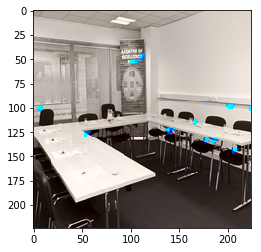

torch.Size([1, 1, 224, 224])


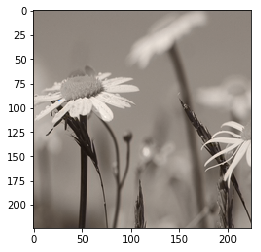

torch.Size([1, 1, 224, 224])


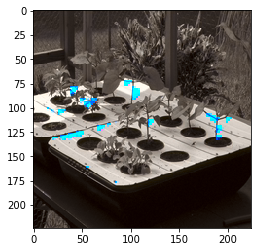

torch.Size([1, 1, 224, 224])


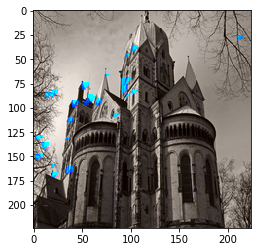

torch.Size([1, 1, 224, 224])


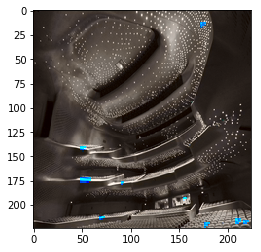

torch.Size([1, 1, 224, 224])


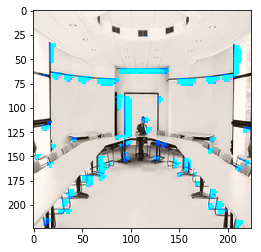

torch.Size([1, 1, 224, 224])


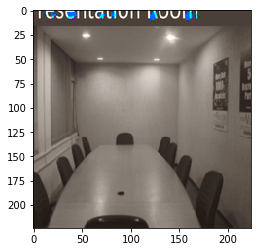

torch.Size([1, 1, 224, 224])


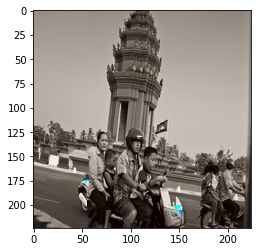

torch.Size([1, 1, 224, 224])


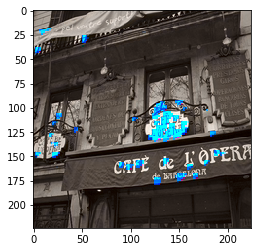

torch.Size([1, 1, 224, 224])


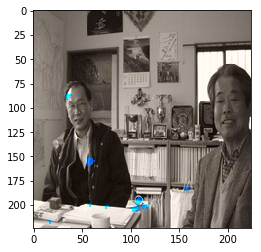

torch.Size([1, 1, 224, 224])


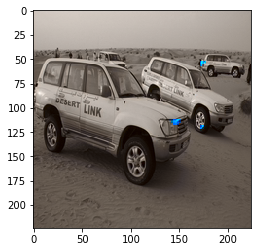

torch.Size([1, 1, 224, 224])


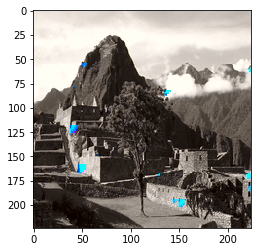

torch.Size([1, 1, 224, 224])


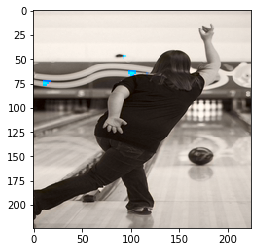

torch.Size([1, 1, 224, 224])


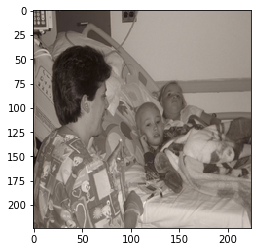

torch.Size([1, 1, 224, 224])


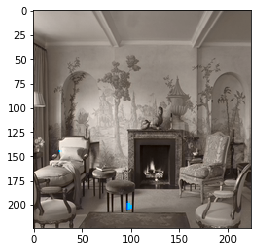

torch.Size([1, 1, 224, 224])


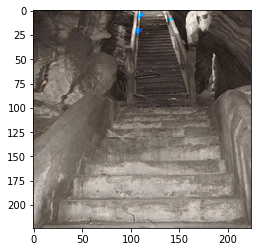

torch.Size([1, 1, 224, 224])


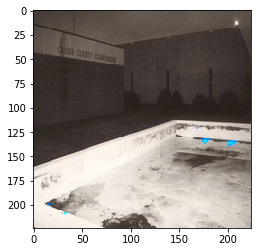

torch.Size([1, 1, 224, 224])


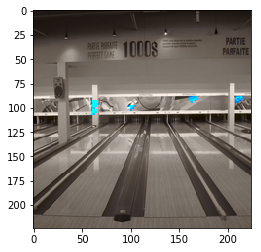

torch.Size([1, 1, 224, 224])


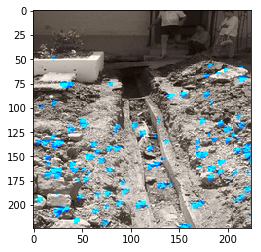

torch.Size([1, 1, 224, 224])


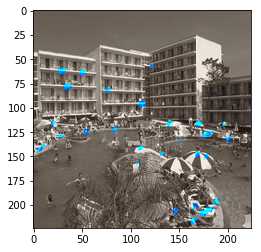

torch.Size([1, 1, 224, 224])


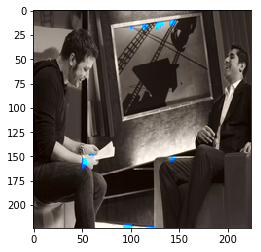

torch.Size([1, 1, 224, 224])


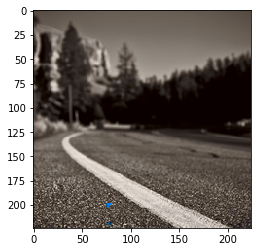

torch.Size([1, 1, 224, 224])


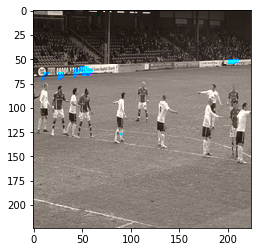

torch.Size([1, 1, 224, 224])


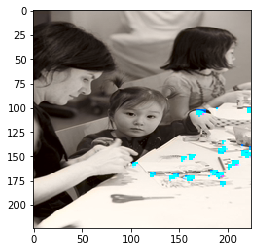

torch.Size([1, 1, 224, 224])


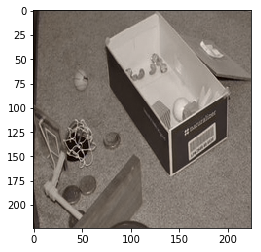

torch.Size([1, 1, 224, 224])


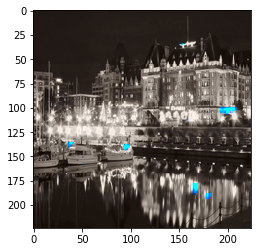

torch.Size([1, 1, 224, 224])


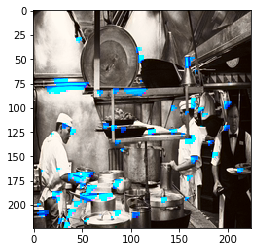

torch.Size([1, 1, 224, 224])


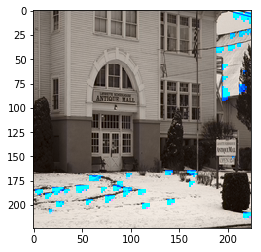

torch.Size([1, 1, 224, 224])


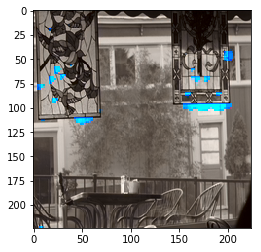

torch.Size([1, 1, 224, 224])


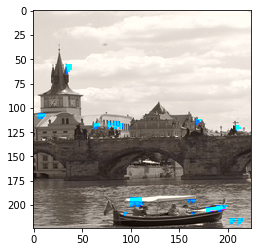

torch.Size([1, 1, 224, 224])


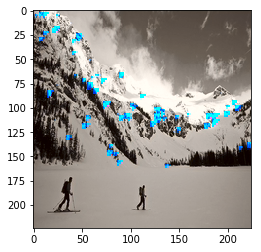

torch.Size([1, 1, 224, 224])


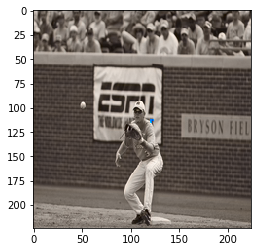

torch.Size([1, 1, 224, 224])


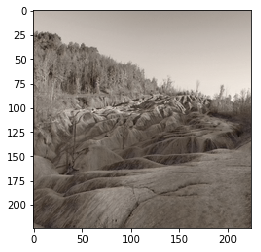

torch.Size([1, 1, 224, 224])


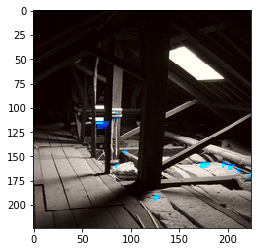

torch.Size([1, 1, 224, 224])


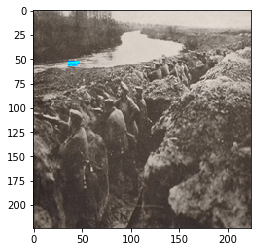

torch.Size([1, 1, 224, 224])


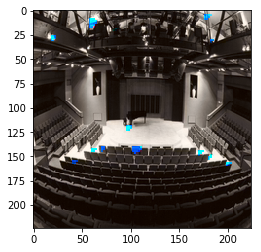

torch.Size([1, 1, 224, 224])


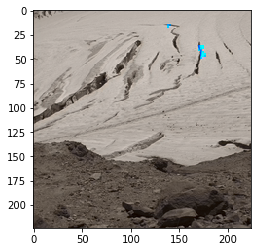

torch.Size([1, 1, 224, 224])


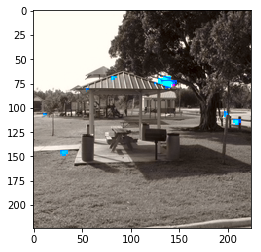

torch.Size([1, 1, 224, 224])


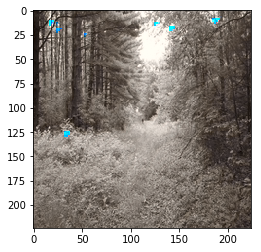

torch.Size([1, 1, 224, 224])


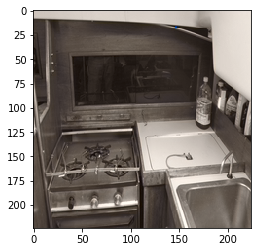

torch.Size([1, 1, 224, 224])


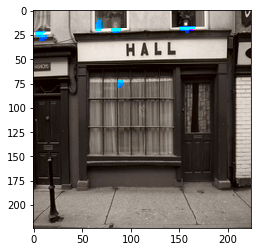

torch.Size([1, 1, 224, 224])


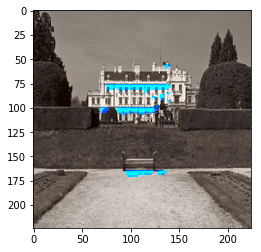

torch.Size([1, 1, 224, 224])


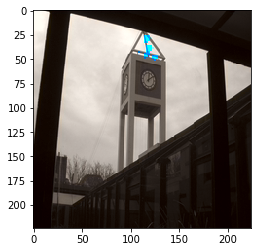

torch.Size([1, 1, 224, 224])


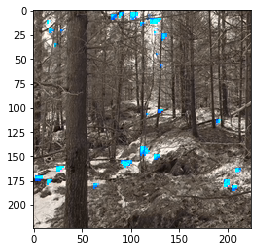

torch.Size([1, 1, 224, 224])


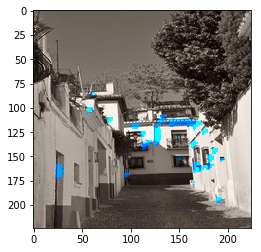

torch.Size([1, 1, 224, 224])


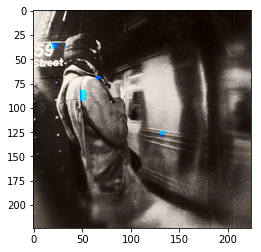

torch.Size([1, 1, 224, 224])


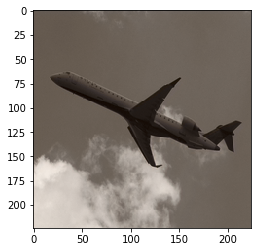

torch.Size([1, 1, 224, 224])


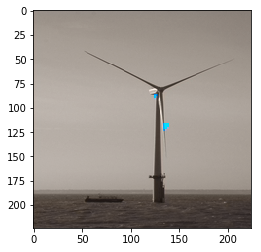

torch.Size([1, 1, 224, 224])


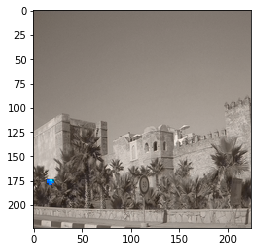

torch.Size([1, 1, 224, 224])


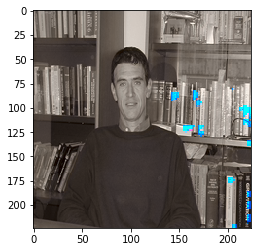

torch.Size([1, 1, 224, 224])


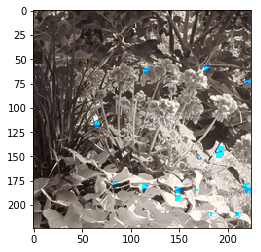

torch.Size([1, 1, 224, 224])


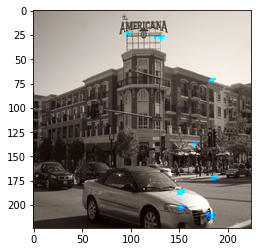

torch.Size([1, 1, 224, 224])


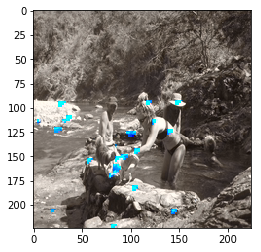

torch.Size([1, 1, 224, 224])


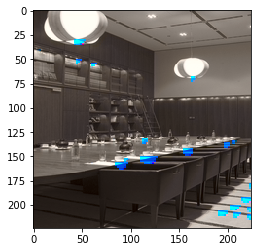

torch.Size([1, 1, 224, 224])


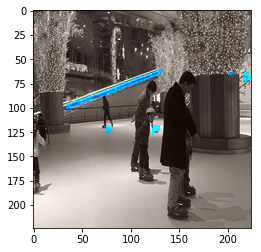

torch.Size([1, 1, 224, 224])


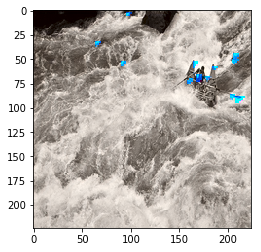

torch.Size([1, 1, 224, 224])


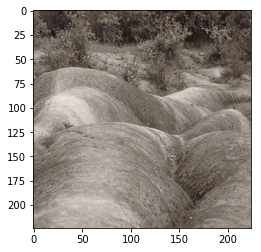

torch.Size([1, 1, 224, 224])


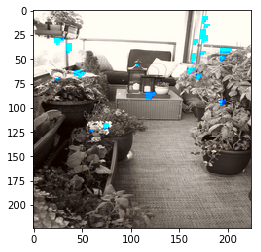

torch.Size([1, 1, 224, 224])


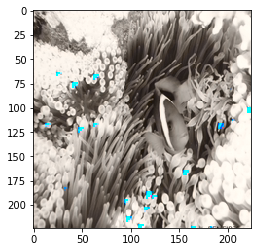

torch.Size([1, 1, 224, 224])


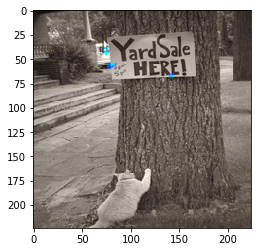

torch.Size([1, 1, 224, 224])


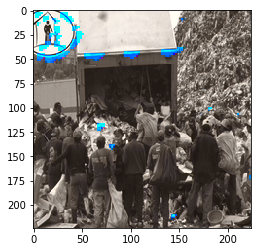

torch.Size([1, 1, 224, 224])


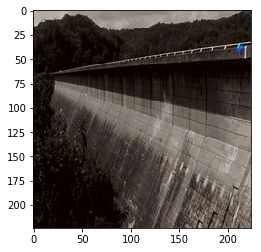

torch.Size([1, 1, 224, 224])


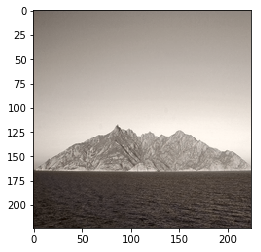

torch.Size([1, 1, 224, 224])


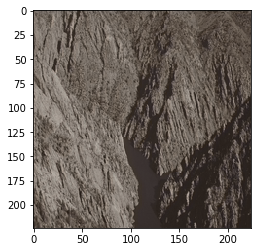

torch.Size([1, 1, 224, 224])


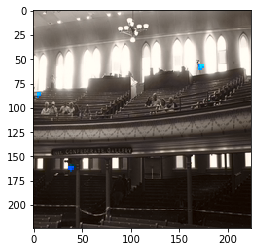

torch.Size([1, 1, 224, 224])


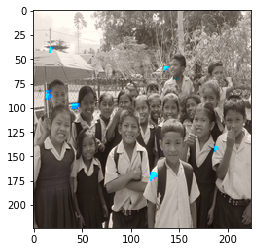

torch.Size([1, 1, 224, 224])


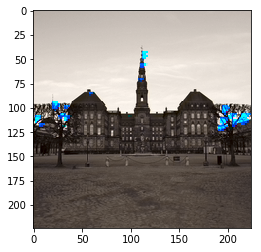

torch.Size([1, 1, 224, 224])


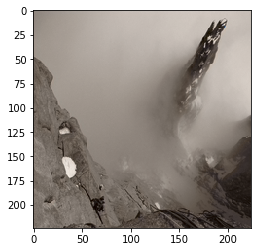

torch.Size([1, 1, 224, 224])


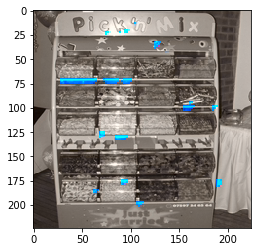

torch.Size([1, 1, 224, 224])


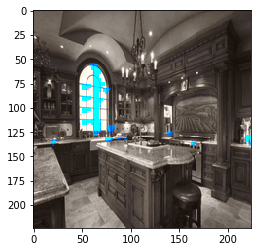

torch.Size([1, 1, 224, 224])


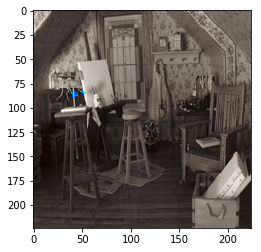

torch.Size([1, 1, 224, 224])


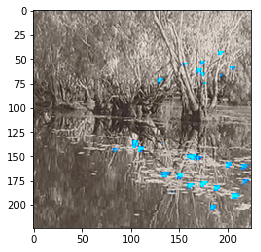

torch.Size([1, 1, 224, 224])


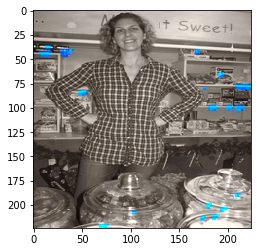

torch.Size([1, 1, 224, 224])


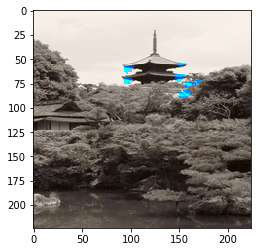

torch.Size([1, 1, 224, 224])


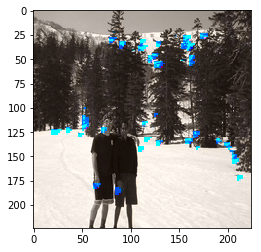

torch.Size([1, 1, 224, 224])


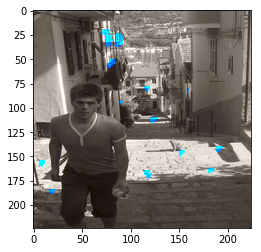

torch.Size([1, 1, 224, 224])


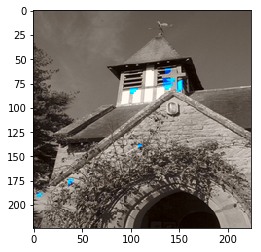

torch.Size([1, 1, 224, 224])


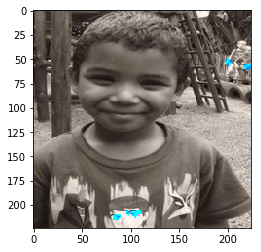

torch.Size([1, 1, 224, 224])


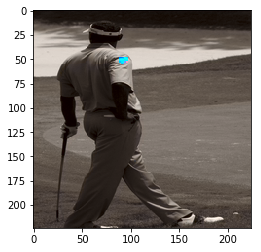

torch.Size([1, 1, 224, 224])


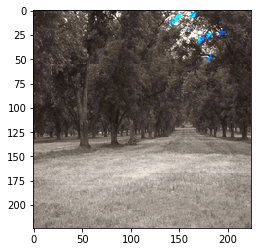

torch.Size([1, 1, 224, 224])


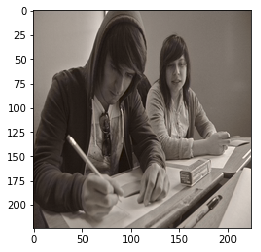

torch.Size([1, 1, 224, 224])


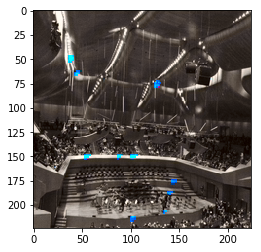

torch.Size([1, 1, 224, 224])


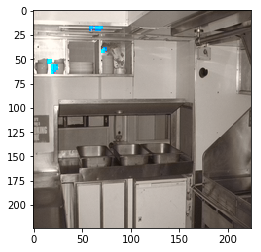

torch.Size([1, 1, 224, 224])


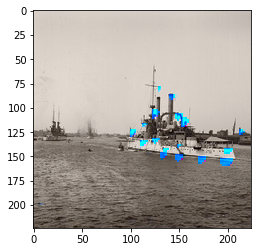

torch.Size([1, 1, 224, 224])


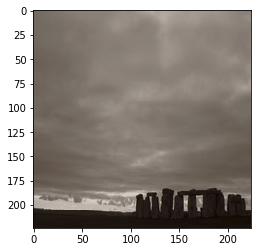

torch.Size([1, 1, 224, 224])


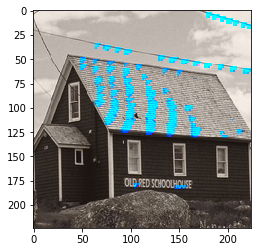

torch.Size([1, 1, 224, 224])


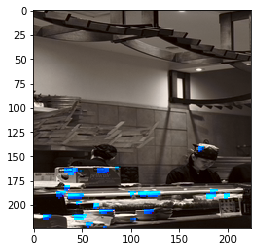

torch.Size([1, 1, 224, 224])


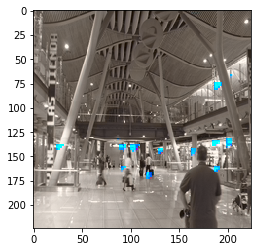

torch.Size([1, 1, 224, 224])


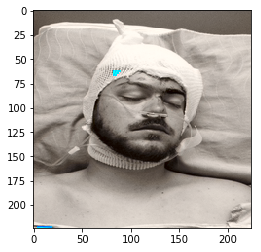

torch.Size([1, 1, 224, 224])


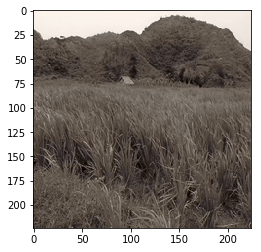

torch.Size([1, 1, 224, 224])


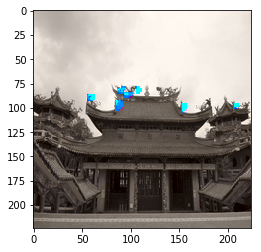

torch.Size([1, 1, 224, 224])


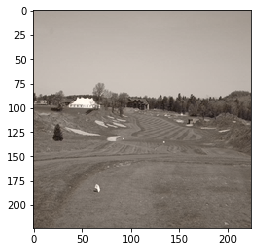

torch.Size([1, 1, 224, 224])


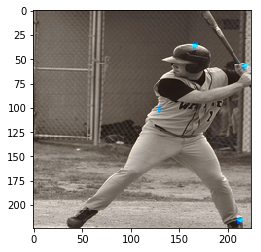

torch.Size([1, 1, 224, 224])


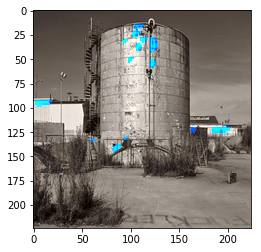

torch.Size([1, 1, 224, 224])


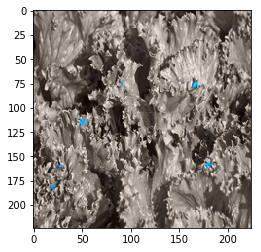

torch.Size([1, 1, 224, 224])


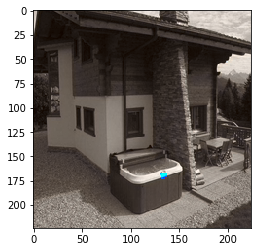

torch.Size([1, 1, 224, 224])


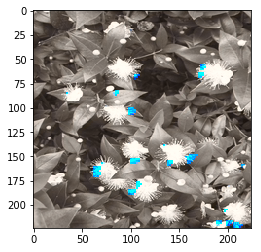

In [ ]:
 for i in range(100):
    temp=test_folder[i][0].unsqueeze(0).cuda()
    out=model(temp)
    print(temp.cpu().shape)
    color_image = torch.cat((temp.cpu().squeeze(0), out.detach().cpu().squeeze(0)), 0).numpy() # combine channels
    color_image = color_image.transpose((1, 2, 0))  # rescale for matplotlib
    color_image[:, :, 0:1] = color_image[:, :, 0:1] * 100
    color_image[:, :, 1:3] = color_image[:, :, 1:3] * 255 - 128   
    color_image = lab2rgb(color_image.astype(np.float64))
    plt.imshow(color_image)
    plt.show()

torch.Size([1, 1, 224, 224])


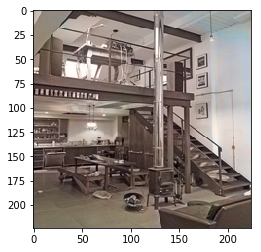

torch.Size([1, 1, 224, 224])


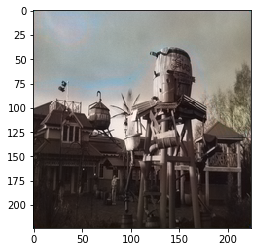

torch.Size([1, 1, 224, 224])


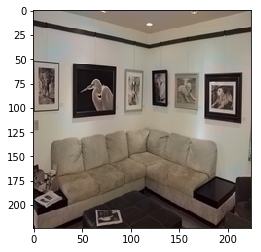

torch.Size([1, 1, 224, 224])


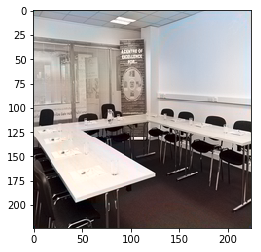

torch.Size([1, 1, 224, 224])


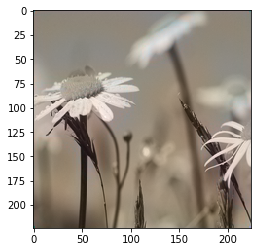

torch.Size([1, 1, 224, 224])


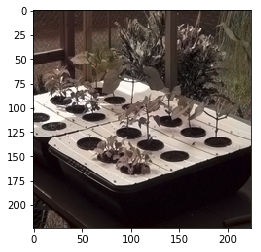

torch.Size([1, 1, 224, 224])


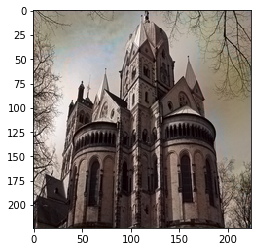

torch.Size([1, 1, 224, 224])


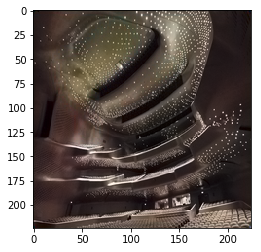

torch.Size([1, 1, 224, 224])


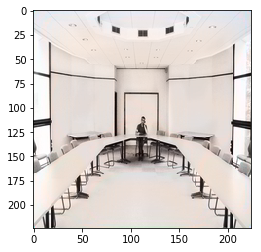

torch.Size([1, 1, 224, 224])


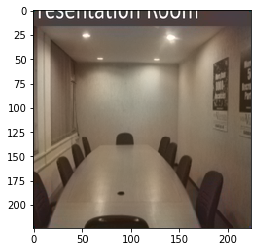

torch.Size([1, 1, 224, 224])


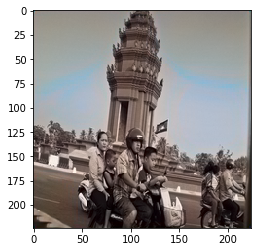

torch.Size([1, 1, 224, 224])


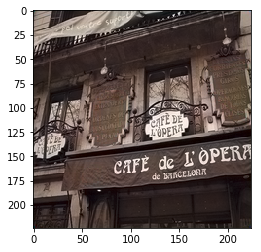

torch.Size([1, 1, 224, 224])


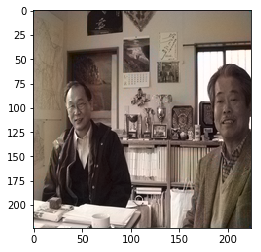

torch.Size([1, 1, 224, 224])


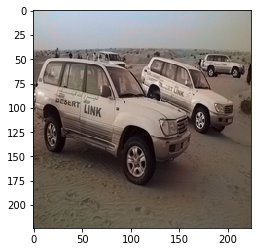

torch.Size([1, 1, 224, 224])


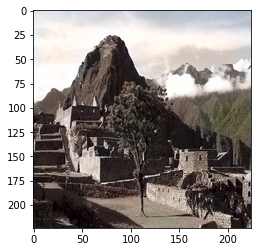

torch.Size([1, 1, 224, 224])


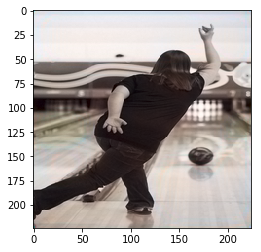

torch.Size([1, 1, 224, 224])


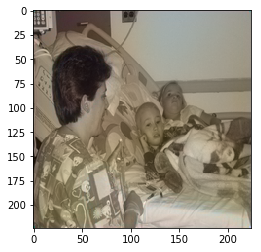

torch.Size([1, 1, 224, 224])


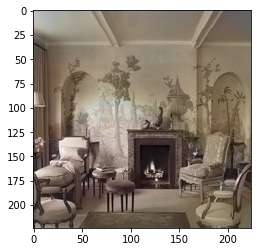

torch.Size([1, 1, 224, 224])


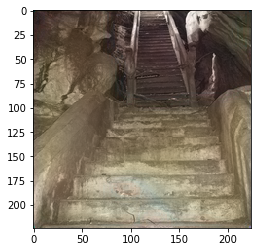

torch.Size([1, 1, 224, 224])


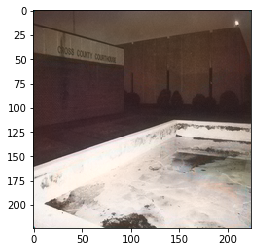

torch.Size([1, 1, 224, 224])


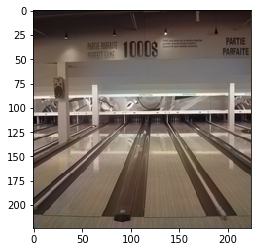

torch.Size([1, 1, 224, 224])


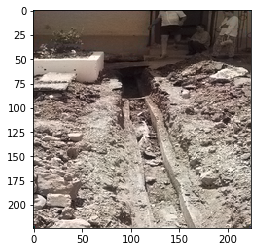

torch.Size([1, 1, 224, 224])


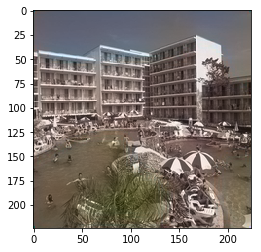

torch.Size([1, 1, 224, 224])


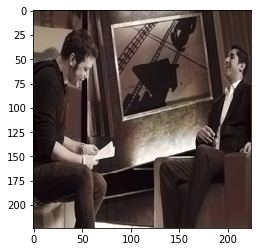

torch.Size([1, 1, 224, 224])


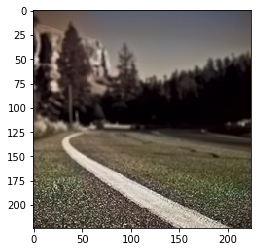

torch.Size([1, 1, 224, 224])


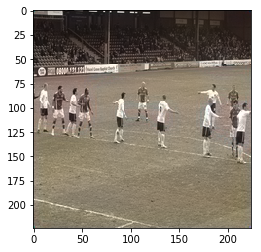

torch.Size([1, 1, 224, 224])


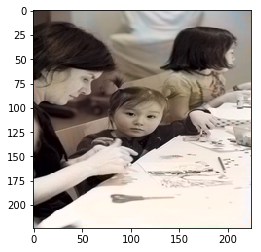

torch.Size([1, 1, 224, 224])


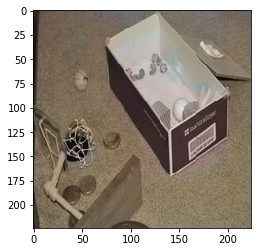

torch.Size([1, 1, 224, 224])


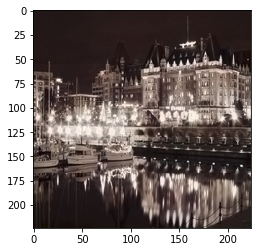

torch.Size([1, 1, 224, 224])


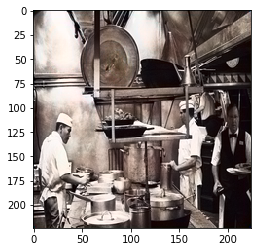

torch.Size([1, 1, 224, 224])


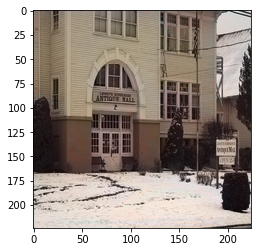

torch.Size([1, 1, 224, 224])


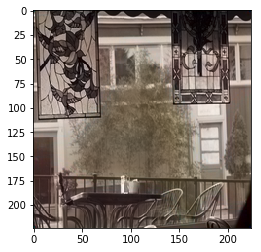

torch.Size([1, 1, 224, 224])


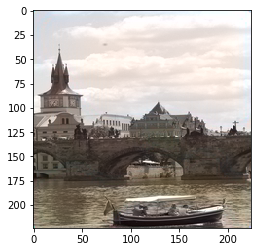

torch.Size([1, 1, 224, 224])


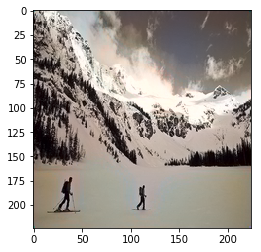

torch.Size([1, 1, 224, 224])


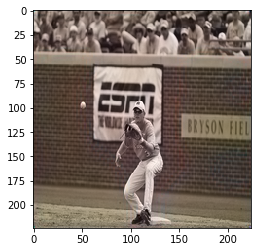

torch.Size([1, 1, 224, 224])


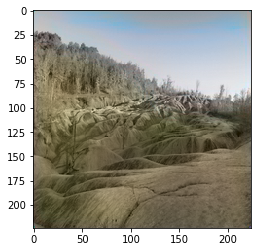

torch.Size([1, 1, 224, 224])


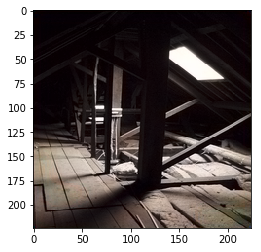

torch.Size([1, 1, 224, 224])


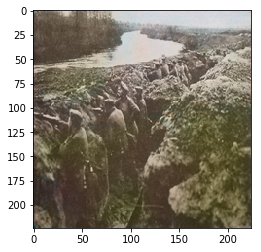

torch.Size([1, 1, 224, 224])


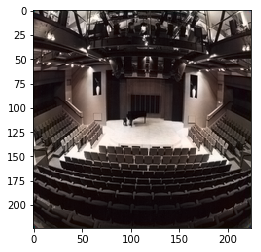

torch.Size([1, 1, 224, 224])


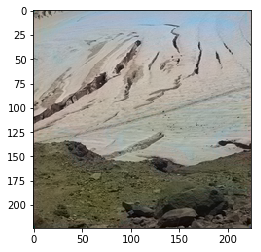

torch.Size([1, 1, 224, 224])


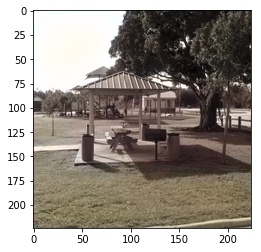

torch.Size([1, 1, 224, 224])


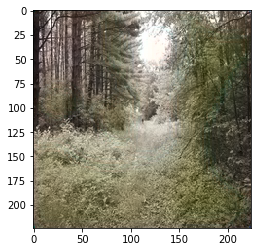

torch.Size([1, 1, 224, 224])


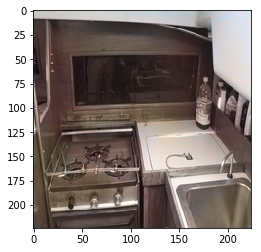

torch.Size([1, 1, 224, 224])


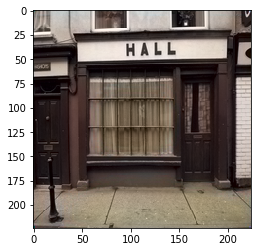

torch.Size([1, 1, 224, 224])


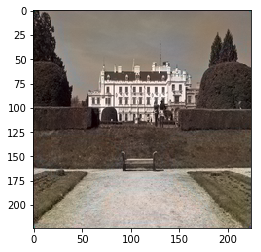

torch.Size([1, 1, 224, 224])


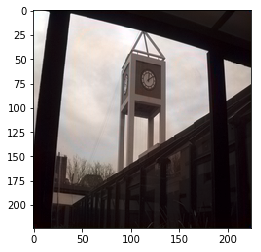

torch.Size([1, 1, 224, 224])


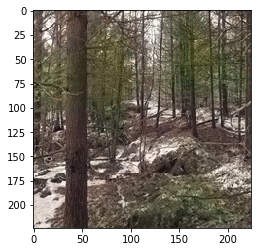

torch.Size([1, 1, 224, 224])


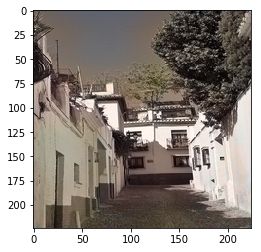

torch.Size([1, 1, 224, 224])


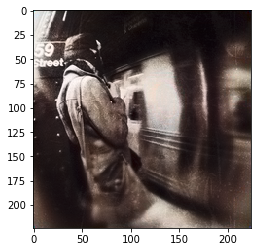

torch.Size([1, 1, 224, 224])


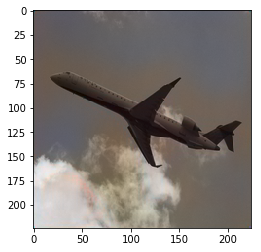

torch.Size([1, 1, 224, 224])


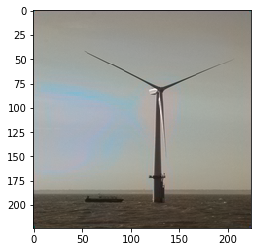

torch.Size([1, 1, 224, 224])


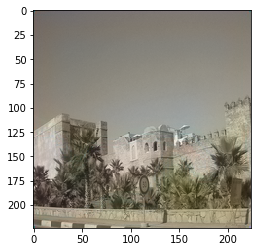

torch.Size([1, 1, 224, 224])


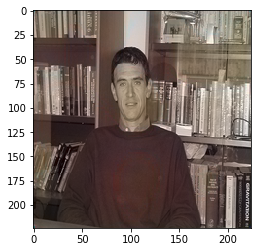

torch.Size([1, 1, 224, 224])


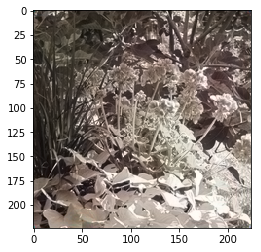

torch.Size([1, 1, 224, 224])


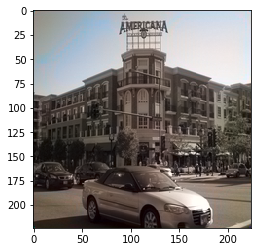

torch.Size([1, 1, 224, 224])


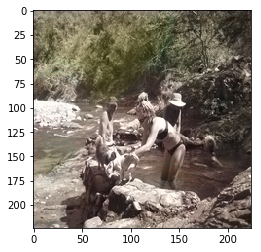

torch.Size([1, 1, 224, 224])


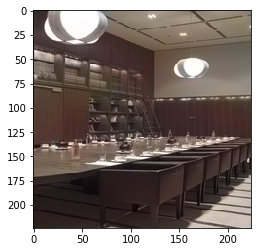

torch.Size([1, 1, 224, 224])


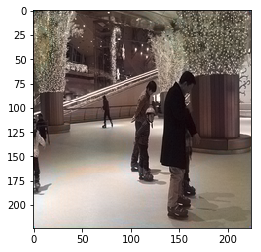

torch.Size([1, 1, 224, 224])


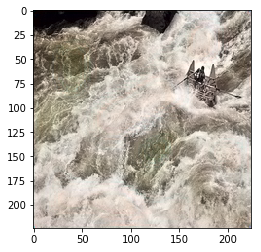

torch.Size([1, 1, 224, 224])


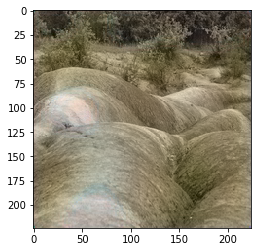

torch.Size([1, 1, 224, 224])


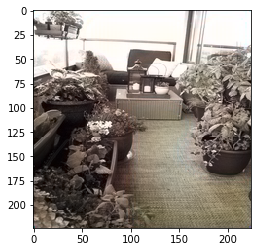

torch.Size([1, 1, 224, 224])


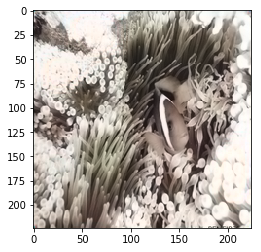

torch.Size([1, 1, 224, 224])


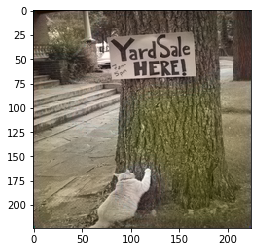

torch.Size([1, 1, 224, 224])


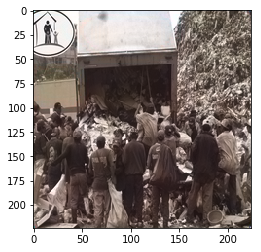

torch.Size([1, 1, 224, 224])


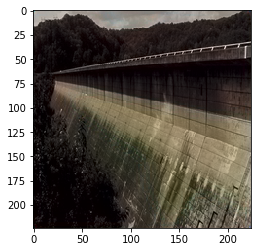

torch.Size([1, 1, 224, 224])


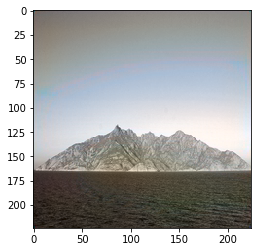

torch.Size([1, 1, 224, 224])


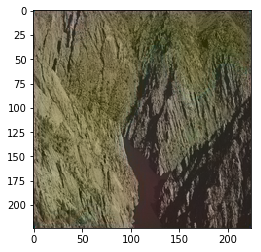

torch.Size([1, 1, 224, 224])


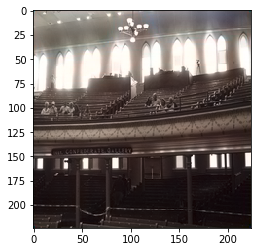

torch.Size([1, 1, 224, 224])


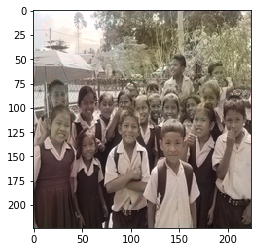

torch.Size([1, 1, 224, 224])


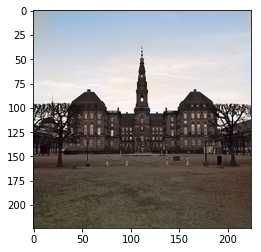

torch.Size([1, 1, 224, 224])


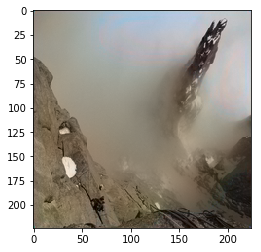

torch.Size([1, 1, 224, 224])


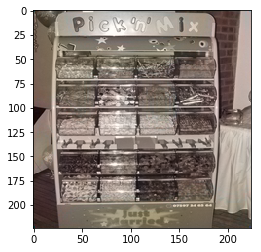

torch.Size([1, 1, 224, 224])


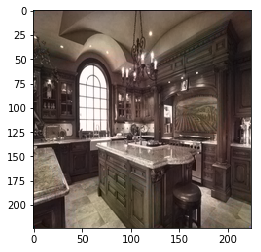

torch.Size([1, 1, 224, 224])


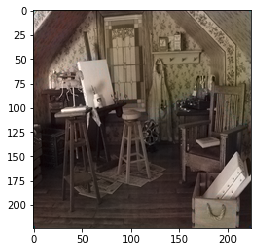

torch.Size([1, 1, 224, 224])


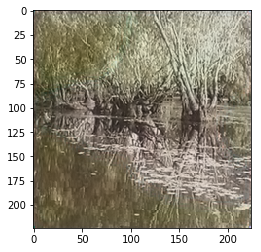

torch.Size([1, 1, 224, 224])


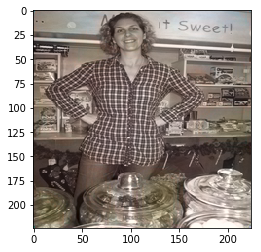

torch.Size([1, 1, 224, 224])


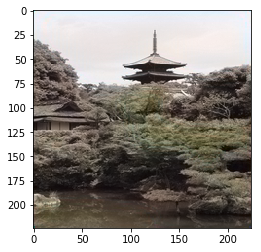

torch.Size([1, 1, 224, 224])


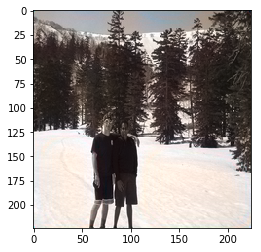

torch.Size([1, 1, 224, 224])


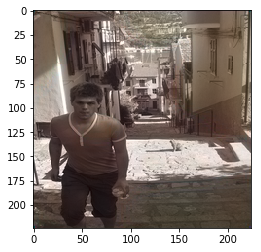

torch.Size([1, 1, 224, 224])


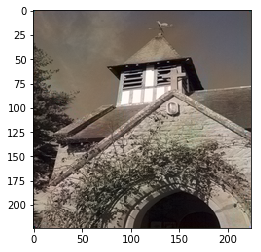

torch.Size([1, 1, 224, 224])


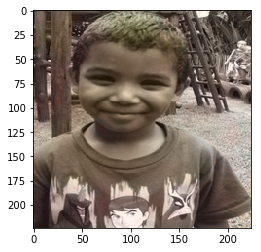

torch.Size([1, 1, 224, 224])


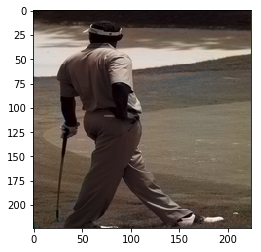

torch.Size([1, 1, 224, 224])


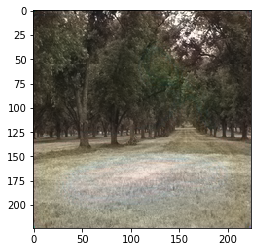

torch.Size([1, 1, 224, 224])


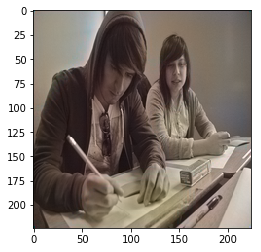

torch.Size([1, 1, 224, 224])


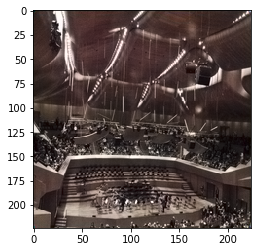

torch.Size([1, 1, 224, 224])


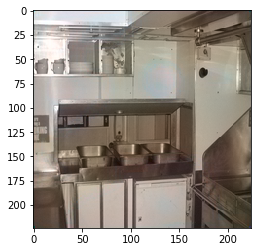

torch.Size([1, 1, 224, 224])


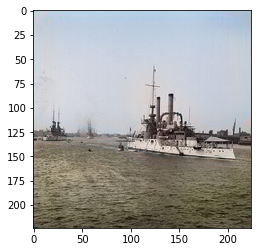

torch.Size([1, 1, 224, 224])


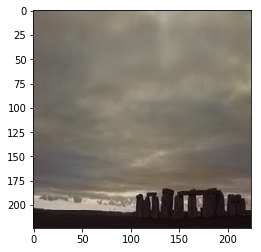

torch.Size([1, 1, 224, 224])


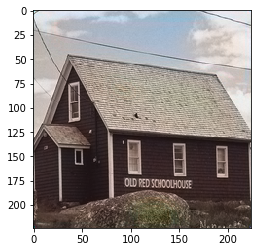

torch.Size([1, 1, 224, 224])


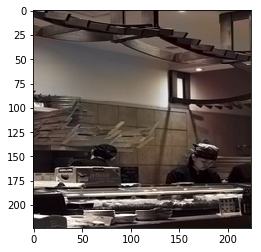

torch.Size([1, 1, 224, 224])


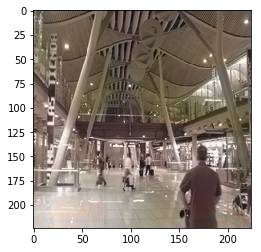

torch.Size([1, 1, 224, 224])


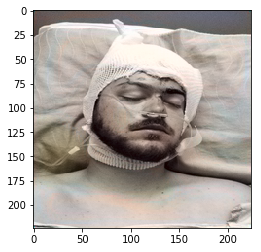

torch.Size([1, 1, 224, 224])


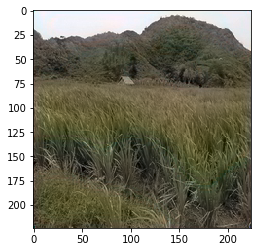

torch.Size([1, 1, 224, 224])


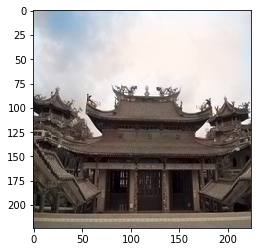

torch.Size([1, 1, 224, 224])


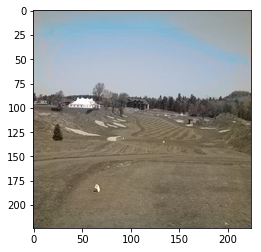

torch.Size([1, 1, 224, 224])


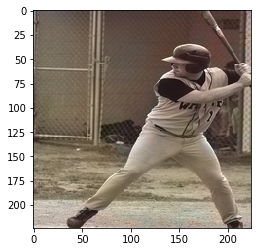

torch.Size([1, 1, 224, 224])


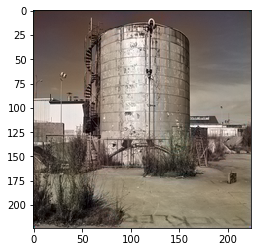

torch.Size([1, 1, 224, 224])


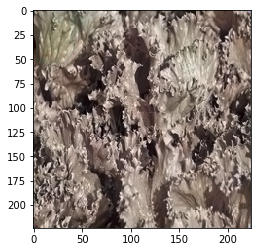

torch.Size([1, 1, 224, 224])


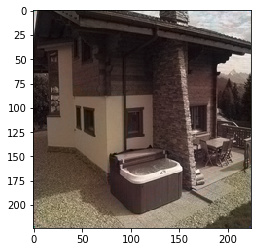

torch.Size([1, 1, 224, 224])


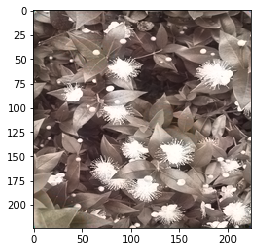

In [ ]:
########################################################
 for i in range(100):
    temp=test_folder[i][0].unsqueeze(0).cuda()
    out=model(temp)
    print(temp.cpu().shape)
    color_image = torch.cat((temp.cpu().squeeze(0), out.detach().cpu().squeeze(0)), 0).numpy() # combine channels
    color_image = color_image.transpose((1, 2, 0))  # rescale for matplotlib
    color_image[:, :, 0:1] = color_image[:, :, 0:1] * 100
    color_image[:, :, 1:3] = color_image[:, :, 1:3] * 255 - 128   
    color_image = lab2rgb(color_image.astype(np.float64))
    plt.imshow(color_image)
    plt.show()

## Helper function 

In [ ]:
def to_rgb (gray_input, ab_input):
  colourImage=torch.cat((gray_input.cpu(), ab_input.cpu()),0).detach().numpy()
  colourImage=colourImage.transpose(1,2,0)
  colourImage[:,:,0:1]=colourImage[:,:,0:1]
  colourImage[:,:,1:3]=colourImage[:,:,1:3]*255-128
  colourImage=lab2rgb(colourImage.astype(np.float64))
  plt.imshow(colourImage)
  plt.show()

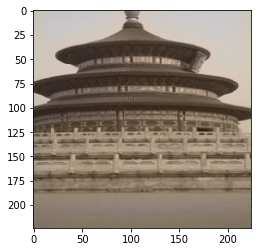

In [ ]:
to_rgb(sample,other_chanel)

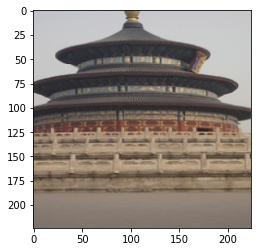

In [ ]:
to_rgb(sample,truth)

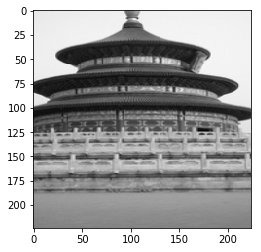

In [ ]:
plt.imshow(sample.cpu()[0], cmap="gray")
plt.show()

# Evaluation


## Pixel2Pixel RGB comparison

In [ ]:
!unzip Train.zip
!unzip Validation.zip
!unzip Test.zip

In [ ]:
!unzip project_val.zip

In [ ]:
%cd project_val/

/content/project_val


In [ ]:
import matplotlib as mp
import matplotlib.pyplot as plt
import numpy as np
import torch
import cv2


im1 = cv2.imread('6.jpg',0)
im11 = cv2.imread('img-6-epoch-99.jpg',0)
res=cv2.absdiff(im1,im11)
res= res.astype(np.uint8)
percentage=np.sum(np.absolute(im1-im11))/(224*224)/255
percentage

In [ ]:
import sys

from scipy.misc import imread
from scipy.linalg import norm
from scipy import sum, average

In [ ]:
import imageio


im1 = imageio.imread('0.jpg')
im11 = imageio.imread('R1.jpg')
im2 = imageio.imread('1.jpg')
im22 = imageio.imread('R2.jpg')
im3 = imageio.imread('2.jpg')
im33 = imageio.imread('R3.jpg')
im5 = imageio.imread('3.jpg')
im55 = imageio.imread('R4.jpg')
im6 = imageio.imread('5.jpg')
im66 = imageio.imread('R6.jpg')
im7 = imageio.imread('6.jpg')
im77 = imageio.imread('R7.jpg')
im8 = imageio.imread('7.jpg')
im88 = imageio.imread('R8.jpg')
im9 = imageio.imread('8.jpg')
im99 = imageio.imread('R9.jpg')

In [ ]:
percentage=np.sum(abs(im1-im11))/3/(224*224)/255+np.sum(abs(im2-im22))/3/(224*224)/255+np.sum(abs(im3-im33))/3/(224*224)/255
percentage2=np.sum(abs(im5-im55))/3/(224*224)/255+np.sum(abs(im6-im66))/3/(224*224)/255+np.sum(abs(im7-im77))/3/(224*224)/255
percentage3=np.sum(abs(im8-im88))/3/(224*224)/255+np.sum(abs(im9-im99))/3/(224*224)/255
print(1-(percentage+percentage2+percentage3)/9)

0.6431713947152935
